In [ ]:
import os
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from skimage.io import imread
from sklearn.metrics import classification_report, accuracy_score
from skimage.transform import resize
from google.colab import drive
drive.mount('/content/drive',force_remount=True)
os.listdir('/content/drive/My Drive')
data='/content/drive/My Drive/pet'
os.listdir(data)

Mounted at /content/drive


['cats', 'dogs']

In [ ]:
images=[]
labels=[]
cat_count=0
dog_count=0
def load_images_from_folder(folder):
    img_array=[]
    global cat_count,dog_count
    for entry in os.scandir(folder):
        if entry.is_dir():
            load_images_from_folder(entry.path)  # Recursively load from subdirectories
        elif entry.is_file() and entry.name.lower().endswith(('.jpg', '.jpeg', '.png')):
            try:
                print(f"Loading image: {entry.path}")
                img = Image.open(entry.path)
                img = img.resize((64, 64))
                img_array = np.array(img)
                images.append(img_array)
                if (entry.name[0]=="c"):
                    labels.append(0)
                    cat_count +=1
                else:
                    labels.append(1)
                    dog_count += 1
            except Exception as e:
                print(f"Error loading image {entry.path}: {e}")
load_images_from_folder(data)
if len(images) == 0:
    print("No images were loaded. Please check the path and file extensions.")
else:
    images = np.array(images)
    labels = np.array(labels)
    print(f"Number of cat images: {cat_count}")
    print(f"Number of dog images: {dog_count}")
    print("Images shape:", images.shape)
    print("Labels shape:", labels.shape)

Loading image: /content/drive/My Drive/pet/cats/cat.4007.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4018.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4014.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4013.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4016.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4020.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4024.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4023.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4022.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4017.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4019.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4021.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4015.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4032.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4037.jpg
Loading image: /content/drive/My Drive/pet/cats/cat.4034.jpg
Loading image: /content/

In [ ]:
    n_samples, height, width, n_channels = images.shape
    x = images.reshape(n_samples, height * width * n_channels)
    x = x / 255.0
    x_train, x_test, y_train, y_test = train_test_split(x, labels, test_size=0.2, random_state=42)
    print("Training data shape:", x_train.shape)
    print("Test data shape:", x_test.shape)
    print("Training labels shape:", y_train.shape)
    print("Test labels shape:", y_test.shape)
    # Train an SVM classifier
    clf=SVC(kernel='linear', random_state=42)
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    report = classification_report(y_test, y_pred, target_names=['Cat', 'Dog'])
    print("Accuracy:", accuracy)
    print("Classification Report:\n", report)

Training data shape: (1618, 12288)
Test data shape: (405, 12288)
Training labels shape: (1618,)
Test labels shape: (405,)
Accuracy: 0.5209876543209877
Classification Report:
               precision    recall  f1-score   support

         Cat       0.54      0.54      0.54       209
         Dog       0.51      0.51      0.51       196

    accuracy                           0.52       405
   macro avg       0.52      0.52      0.52       405
weighted avg       0.52      0.52      0.52       405



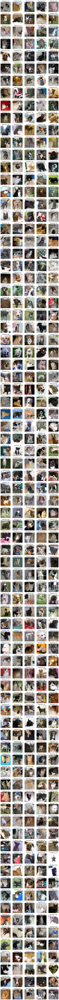

In [ ]:

    def plot_predictions(image_arrays, predictions, image_size=(128, 128), n_cols=5):
        n_images = len(image_arrays)
        n_rows = (n_images + n_cols - 1) // n_cols
        plt.figure(figsize=(n_cols * 2, n_rows * 2))
        for i in range(n_images):
            img_array = image_arrays[i]
            img_array = (img_array * 255).astype(np.uint8) #Converting to 8-bit image
            img = Image.fromarray(img_array)
            plt.subplot(n_rows, n_cols, i + 1)
            plt.imshow(img)
            plt.title('Predicted: ' + ('Cat' if predictions[i] == 0 else 'Dog'))
            plt.axis('off')
        plt.tight_layout()
        plt.show()
    test_images = x_test.reshape(-1, height, width, n_channels)
    plot_predictions(test_images, y_pred)